<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#LAS" data-toc-modified-id="LAS-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>LAS</a></span><ul class="toc-item"><li><span><a href="#Metadata" data-toc-modified-id="Metadata-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Metadata</a></span></li><li><span><a href="#Geographic-coordinates" data-toc-modified-id="Geographic-coordinates-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Geographic coordinates</a></span><ul class="toc-item"><li><span><a href="#Spatial-reference-system" data-toc-modified-id="Spatial-reference-system-1.2.1"><span class="toc-item-num">1.2.1&nbsp;&nbsp;</span>Spatial reference system</a></span></li><li><span><a href="#Proj4" data-toc-modified-id="Proj4-1.2.2"><span class="toc-item-num">1.2.2&nbsp;&nbsp;</span>Proj4</a></span></li><li><span><a href="#Transformation" data-toc-modified-id="Transformation-1.2.3"><span class="toc-item-num">1.2.3&nbsp;&nbsp;</span>Transformation</a></span></li></ul></li><li><span><a href="#Shapely-bbox" data-toc-modified-id="Shapely-bbox-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Shapely bbox</a></span></li><li><span><a href="#GeoJSON-bbox" data-toc-modified-id="GeoJSON-bbox-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>GeoJSON bbox</a></span></li><li><span><a href="#Map-coverage" data-toc-modified-id="Map-coverage-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>Map coverage</a></span></li></ul></li><li><span><a href="#Vector" data-toc-modified-id="Vector-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Vector</a></span><ul class="toc-item"><li><span><a href="#Intersection" data-toc-modified-id="Intersection-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Intersection</a></span></li></ul></li></ul></div>

In [36]:
from pyproj import Proj, transform
from shapely.geometry import box
import geopandas as gpd
import numpy as np
import folium
import pylas

# shapefiles
kudzuSE = "polygons_kudzuPredN10k/SEkudzuPred.shp"

# las
fnstr = "USGS_LPC_TN_Eastern_2_16_B16_Del1_2016_2486549NE_LAS_2017"
fnget = lambda tail: fnstr+"/"+fnstr+tail

## LAS

In [2]:
las = pylas.read(fnget(".las"))

las

<LasData(1.4, point fmt: <PointFormat(6)>, 16209025 points, 1 vlrs)>

### Metadata

In [3]:
# get metadata
meta = {f: getattr(las.header, f) for f in dir(las.header) if f[0]!="_"}

# pretty print the metadata
print('{:>35}  {:>35}'.format("ATTRIBUTE", "VALUE")+"\n"+"-"*100)
for f,v in meta.items(): print('{:>35}  {:>35}'.format(f, str(v)))

                          ATTRIBUTE                                VALUE
----------------------------------------------------------------------------------------------------
              are_points_compressed                                False
               creation_day_of_year                                   13
                      creation_year                                 2017
                               date                           2017-01-13
                     file_signature                              b'LASF'
                     file_source_id                                    0
                generating_software                b'GeoCue LAS Updater'
                    global_encoding  <pylas.headers.rawheader.GlobalEncoding object at 0x000002369FD8EB48>
  legacy_number_of_points_by_return  <pylas.headers.rawheader.c_ulong_Array_5 object at 0x000002369FD8EAC8>
                 legacy_point_count                                    0
                           

### Geographic coordinates

#### Spatial reference system
Print the spatial reference information from the readme:

In [4]:
with open(fnget("_meta.txt"), "r") as f:
    print("".join(f.readlines()[98:123]))

Spatial_Reference_Information:
  Horizontal_Coordinate_System_Definition:
    Planar:
      Grid_Coordinate_System:
        Grid_Coordinate_System_Name: State Plane Coordinate System 1983
        State_Plane_Coordinate_System:
          SPCS_Zone_Identifier: 4100
          Lambert_Conformal_Conic:
            Standard_Parallel: 35.25
            Standard_Parallel: 36.4166666666667
            Longitude_of_Central_Meridian: -86
            Latitude_of_Projection_Origin: 34.3333333333333
            False_Easting: 1968500
            False_Northing: 0
      Planar_Coordinate_Information:
        Planar_Coordinate_Encoding_Method: coordinate pair
        Coordinate_Representation:
          Abscissa_Resolution: 0.000328083333333333
          Ordinate_Resolution: 0.000328083333333333
        Planar_Distance_Units: Foot_US
    Geodetic_Model:
      Horizontal_Datum_Name: GCS NAD 1983 2011
      Ellipsoid_Name: GRS 1980
      Semi-major_Axis: 6378137
      Denominator_of_Flattening_Ratio: 29

#### Proj4
Make a proj4 string that includes those projection parameters:

In [20]:
proj4string = (
    "+proj=lcc "                         # projected coordinate system
    "+lat_1=36.41666666666666 "          # standard parallel 1
    "+lat_2=35.25 "                      # standard parallel 2 
    "+lat_0=34.33333333333334 "          # latitude of origin
    "+lon_0=-86 "                        # longitude of central meridian
    "+x_0=1968500 "
    "+y_0=0 "
    "+ellps=GRS80 "
    "+datum=NAD83 "
    "+to_meter=0.3048006096012192 "
    "+no_defs ")

proj4string

'+proj=lcc +lat_1=36.41666666666666 +lat_2=35.25 +lat_0=34.33333333333334 +lon_0=-86 +x_0=1968500 +y_0=0 +ellps=GRS80 +datum=NAD83 +to_meter=0.3048006096012192 +no_defs '

#### Transformation

Define simple lambda function to apply coordinate transformation to latitude and longitude:

In [21]:
src_proj = Proj(proj4string)                               # pyproj.Proj
trg_proj = Proj(init="epsg:4326")                          # ...
toLonLat = lambda x,y: transform(src_proj, trg_proj, x, y) # pyproj.transform

toLonLat(meta["x_min"], meta["y_min"])                     # TEST IT      

(-79.93098224683156, 39.171368847444185)

Apply to bounding state plane coordinates:

In [22]:
coordinate_pairs = [
    (meta["x_min"], meta["y_min"]),
    (meta["x_max"], meta["y_min"]),
    (meta["x_max"], meta["y_max"]),
    (meta["x_min"], meta["y_max"])]

LL = [toLonLat(cp[0], cp[1]) for cp in coordinate_pairs]
LL

[(-79.93098224683156, 39.171368847444185),
 (-79.85027403231989, 39.167441911143776),
 (-79.84737101963879, 39.2033402627554),
 (-79.92811713592032, 39.20726887934098)]

Add the bounding coordinates to the metadata dictionary:

In [23]:
lon, lat = [c[0] for c in LL], [c[1] for c in LL]

meta["lon_min"] = min(lon)
meta["lat_min"] = min(lat)
meta["lon_max"] = max(lon)
meta["lat_max"] = max(lat)
centroid = [(max(lat)+min(lat))/2, (max(lon)+min(lon))/2]

centroid

[39.18735539524238, -79.88917663323517]

### Shapely bbox

We may have use for shapely geometries later depending on the functionality available in `pylas`:

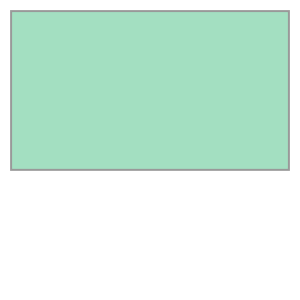

In [24]:
bbox = box(
   float(meta["x_min"]),    # min x 
   float(meta["y_min"]),    # min y
   float(meta["x_max"]),    # max x
   float(meta["y_max"]))    # max y

bbox

### GeoJSON bbox

In [25]:
bbox_geojson = """{{
  "type": "Feature",
  "properties": {{}},
  "geometry": {{
    "type": "Polygon",
    "coordinates": [
      [[{lon_min}, {lat_min}],
       [{lon_max}, {lat_min}],
       [{lon_max}, {lat_max}],
       [{lon_min}, {lat_max}],
       [{lon_min}, {lat_min}]]
    ]
  }}
}}""".format(**meta)

print(bbox_geojson)

{
  "type": "Feature",
  "properties": {},
  "geometry": {
    "type": "Polygon",
    "coordinates": [
      [[-79.93098224683156, 39.167441911143776],
       [-79.84737101963879, 39.167441911143776],
       [-79.84737101963879, 39.20726887934098],
       [-79.93098224683156, 39.20726887934098],
       [-79.93098224683156, 39.167441911143776]]
    ]
  }
}


### Map coverage

Check the spatial extent of the LAS file on an interactive map:

In [41]:
sfunc = lambda f: {'color': 'white', 'weight': 1, 'fillOpacity': 0}
hfunc = lambda f: {'color': 'blue', 'weight': 0.8, 'fillOpacity': 0.1}
basemap = ('https://server.arcgisonline.com/ArcGIS/rest/'
           'services/World_Imagery/MapServer/tile/{z}/{y}/{x}')


def get_fmap(options):
    """ """
    return(folium.Map(
        **options,
        attr="ESRI",
        tiles=basemap,
        control_scale=True,
        prefer_canvas=True))


def get_layer(geojson):
    """ """
    return(folium.GeoJson(
        geojson, 
        control=False,
        style_function=sfunc,
        highlight_function=hfunc))


m = get_fmap({"location": centroid, "zoom_start": 11}) # get a folium map
l = get_layer(bbox_geojson)                            # get geojson layer
l.add_to(m)                                            # add layer
m                                                      # display the map

## Vector

Read one of the kudzu shapefiles into a *geodataframe* using `geopandas.read_file` and print the first three rows:

In [38]:
geodf = gpd.read_file(kudzuSE)

geodf.head(3)

,OBJECTID,y16se_Id,y16se_grid,y16se_OBJE,y16se_Id_1,y16se_COUN,y16se_AREA,y16se_MEAN,y16se_OB_1,y16se_Id_2,...,y12nvSD,y14irSD,y14nvSD,y16irSD,y16nvSD,y18irSD,y18nvSD,cluster,region,geometry
0,6,103,151,0,0,0,0.0,0.0,103,103,...,0.130062,18.61172,0.053939,8.529284,0.093109,25.44423,0.062404,12,SE,"POLYGON ((238656.9808 3987220.317600001, 23865..."
1,626,2195,122,0,0,0,0.0,0.0,2195,2195,...,0.096432,16.84994,0.102732,11.578630,0.085802,18.34245,0.165921,12,SE,"POLYGON ((238130.9808 3986836.317600001, 23812..."
2,966,3708,143,0,0,0,0.0,0.0,3708,3708,...,0.058479,19.40229,0.072143,10.297080,0.086098,24.05487,0.070362,12,SE,"POLYGON ((237978.9808 3986695.317600001, 23797..."


Plot all of the polygons on a map:

In [56]:
geodf_json = geodf.to_crs(epsg='4326').to_json() # transform; get geojson
geodf_lyrs = folium.features.GeoJson(geodf_json)
m.add_child(geodf_lyrs)

m

C:\Applications\Python\anaconda3_2\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


### Intersection 

Iterate over the rows and see if any of the polygons intersect the LAS file boundary:

In [39]:
for index, row in geodf.iterrows():
    print(row["geometry"].intersects(bbox))

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
Fals